# Raifhack 2021

In [1]:
!pip install my_lib==0.0.1
!pip install my_lib2==1.0.0

ERROR: Could not find a version that satisfies the requirement my_lib==0.0.1
ERROR: No matching distribution found for my_lib==0.0.1
ERROR: Could not find a version that satisfies the requirement my_lib2==1.0.0
ERROR: No matching distribution found for my_lib2==1.0.0


## Data load

In [2]:
import time as tm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import probscale
import geopy as geopy
import folium # map rendering library
from geopy.geocoders import Nominatim

from lightgbm import LGBMRegressor

from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.model_selection import StratifiedKFold, KFold

print(f"Pandas version: {pd.__version__}")

pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

Pandas version: 1.2.4


In [3]:
PATH = '../data/'

In [4]:
train_df = pd.read_csv(PATH+'train.csv',low_memory=False)
test_df = pd.read_csv(PATH+'test.csv')
submission = pd.read_csv(PATH+'test_submission.csv', index_col=0)

In [5]:
train_df

,city,floor,id,lat,lng,osm_amenity_points_in_0.001,osm_amenity_points_in_0.005,osm_amenity_points_in_0.0075,osm_amenity_points_in_0.01,osm_building_points_in_0.001,osm_building_points_in_0.005,osm_building_points_in_0.0075,osm_building_points_in_0.01,osm_catering_points_in_0.001,osm_catering_points_in_0.005,osm_catering_points_in_0.0075,osm_catering_points_in_0.01,osm_city_closest_dist,osm_city_nearest_name,osm_city_nearest_population,osm_crossing_closest_dist,osm_crossing_points_in_0.001,osm_crossing_points_in_0.005,osm_crossing_points_in_0.0075,osm_crossing_points_in_0.01,osm_culture_points_in_0.001,osm_culture_points_in_0.005,osm_culture_points_in_0.0075,osm_culture_points_in_0.01,osm_finance_points_in_0.001,osm_finance_points_in_0.005,osm_finance_points_in_0.0075,osm_finance_points_in_0.01,osm_healthcare_points_in_0.005,osm_healthcare_points_in_0.0075,osm_healthcare_points_in_0.01,osm_historic_points_in_0.005,osm_historic_points_in_0.0075,osm_historic_points_in_0.01,osm_hotels_points_in_0.005,osm_hotels_points_in_0.0075,osm_hotels_points_in_0.01,osm_leisure_points_in_0.005,osm_leisure_points_in_0.0075,osm_leisure_points_in_0.01,osm_offices_points_in_0.001,osm_offices_points_in_0.005,osm_offices_points_in_0.0075,osm_offices_points_in_0.01,osm_shops_points_in_0.001,osm_shops_points_in_0.005,osm_shops_points_in_0.0075,osm_shops_points_in_0.01,osm_subway_closest_dist,osm_train_stop_closest_dist,osm_train_stop_points_in_0.005,osm_train_stop_points_in_0.0075,osm_train_stop_points_in_0.01,osm_transport_stop_closest_dist,osm_transport_stop_points_in_0.005,osm_transport_stop_points_in_0.0075,osm_transport_stop_points_in_0.01,per_square_meter_price,reform_count_of_houses_1000,reform_count_of_houses_500,reform_house_population_1000,reform_house_population_500,reform_mean_floor_count_1000,reform_mean_floor_count_500,reform_mean_year_building_1000,reform_mean_year_building_500,region,total_square,street,date,realty_type,price_type
0,Пермь,NaN,COL_0,57.998,56.293,4,19,35,52,0,0,0,0,0,2,4,6,3.293,Пермь,1055397.000,0.028,3,6,17,34,0,0,1,1,0,0,1,2,2,3,4,0,0,1,0,0,0,0,1,2,0,1,2,4,4,11,20,28,269.025,3.368,0,0,0,0.003,4,13,21,139937.500,136,49,2503.000,765.000,5.763,5.531,1964.119,1960.959,Пермский край,32.000,S27289,2020-01-05,10,0
1,Шатура,NaN,COL_1,55.574,39.544,3,24,37,59,0,0,0,1,0,2,2,6,43.951,Орехово-Зуево,120184.000,0.089,0,31,50,57,0,1,2,3,0,0,1,2,1,1,3,2,4,6,2,2,2,1,1,2,0,1,2,3,1,12,20,29,102.455,1.477,0,0,0,0.155,4,10,11,60410.714,146,37,1336.000,514.000,2.894,3.528,1952.322,1957.222,Московская область,280.000,S17052,2020-01-05,10,0
2,Ярославль,NaN,COL_2,57.619,39.851,1,30,67,128,0,0,1,1,0,3,6,11,2.676,Ярославль,603961.000,0.201,0,15,29,53,0,1,2,2,0,0,5,9,0,1,3,0,0,0,0,0,1,2,3,6,0,1,6,9,1,16,37,80,243.362,1.455,0,0,0,0.118,9,13,21,45164.761,105,27,1883.000,573.000,6.141,7.222,1968.150,1973.370,Ярославская область,297.400,S16913,2020-01-05,110,0
3,Новокузнецк,NaN,COL_3,53.897,87.109,0,0,5,21,0,0,0,1,0,0,1,4,15.619,Новокузнецк,552105.000,0.861,0,0,0,5,0,0,0,0,0,0,0,1,0,0,3,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,4,11,295.634,9.401,0,0,0,1.037,0,0,3,28805.263,75,2,1801.000,54.000,8.581,9.000,1992.716,2014.000,Кемеровская область,190.000,S10148,2020-01-05,110,0
4,Москва,NaN,COL_4,55.803,37.487,1,23,64,153,0,1,1,1,0,8,14,26,9.995,Химки,232066.000,0.237,0,14,40,78,0,0,0,0,0,0,3,9,2,7,14,0,2,2,1,1,3,3,4,9,0,8,8,12,0,8,33,89,1.110,1.236,0,0,0,0.235,10,32,62,13222.591,144,38,3090.000,619.000,7.264,5.684,1963.229,1960.500,Москва,60.200,S1338,2020-01-05,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279787,Томск,1.0,COL_280111,56.459,84.979,2,33,111,222,0,0,1,1,1,9,24,45,3.615,Томск,576624.000,0.117,0,13,32,62,0,1,1,2,0,1,3,8,0,2,4,1,2,6,2,4,6,1,3,14,0,0,1,6,0,16,67,130,201.668,0.897,0,0,

In [6]:
from enum import IntEnum

UNKNOWN_VALUE = 'missing'

class PriceTypeEnum(IntEnum):
    OFFER_PRICE = 0 # цена из объявления
    MANUAL_PRICE = 1 # цена, полученная путем ручной оценки

## EDA

In [7]:
TARGET = 'per_square_meter_price'

In [ ]:
sns.pairplot(train_df[[
    *train_df.columns[:7],
    TARGET
]])

In [9]:
train_df[['city', TARGET]].groupby(['city']).agg([np.mean, np.median, np.max, np.min, np.std]) \
    .sort_values(('per_square_meter_price', 'mean'), ascending=True)

per_square_meter_price  \
                                                                     mean   
city                                                                        
Киреевский район, пос. Комсомольский                              407.028   
село Верхние Услы                                                 420.585   
Мамонтовский район, с. Мамонтово                                  422.764   
Лужский район, Заклинское с/пос, д. Заклинье                      433.610   
Гагино                                                            440.071   
...                                                                   ...   
Ивановский район, Куликовское с/пос, д. Малинки                997211.111   
Кавалерово                                                    1043760.000   
Красная                                                       1111166.667   
Безенчукский район, Осинки пгт                                1182058.465   
Владивостокский городской округ, пос. Русский, ...            1990000.000   

                                                                            \
                                                        median        amax   
city                                                                         
Киреевский район, пос. Комсомольский                   407.028     407.028   
село Верхние Услы                                      420.585     420.585   
Мамонтовский район, с. Мамонтово                       422.764     422.764   
Лужский район, Заклинское с/пос, д. Заклинье           433.610     433.610   
Гагино                                                 440.071     440.071   
...                                                        ...         ...   
Ивановский район, Куликовское с/пос, д. Малинки     997211.111 1990000.000   
Кавалерово                                         1043760.000 1043760.000   
Красная                                            1111166.667 1111166.667   
Безенчукский район, Осинки пгт                     1182058.465 1182058.465   
Владивостокский городской округ, пос. Русский, ... 1990000.000 1990000.000   

                                                                            
                                                          amin         std  
city                                                                        
Киреевский район, пос. Комсомольский                   407.028         NaN  
село Верхние Услы                                      420.585         NaN  
Мамонтовский район, с. Мамонтово                       422.764         NaN  
Лужский район, Заклинское с/пос, д. Заклинье           433.610         NaN  
Гагино                                                 440.071         NaN  
...                                                        ...         ...  
Ивановский район, Куликовское с/пос, д. Малинки       4422.222 1404015.511  
Кавалерово                                         1043760.000         NaN  
Красная                                            1111166.667         NaN  
Безенчукский район, Осинки пгт                     1182058.465         NaN  
Владивостокский городской округ, пос. Русский, ... 1990000.000         NaN  

[4948 rows x 5 columns]

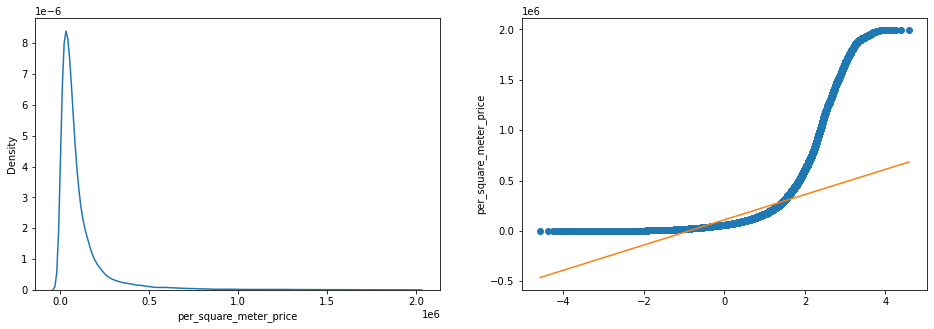

In [10]:
fig, ax = plt.subplots(1, 2, figsize=(16, 5))
sns.kdeplot(train_df[TARGET], ax=ax[0])
fig = probscale.probplot(
    train_df[TARGET],
    ax=ax[1],
    plottype='qq',
    bestfit=True
)
ax[1].set_ylabel(TARGET)
plt.show()

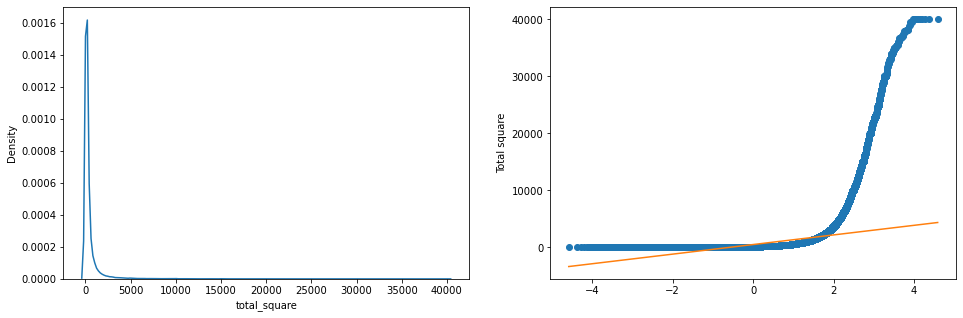

In [11]:
fig, ax = plt.subplots(1, 2, figsize=(16, 5))
sns.kdeplot(train_df['total_square'], ax=ax[0])
fig = probscale.probplot(
    train_df['total_square'],
    ax=ax[1],
    plottype='qq',
    bestfit=True
)
ax[1].set_ylabel('Total square')
plt.show()

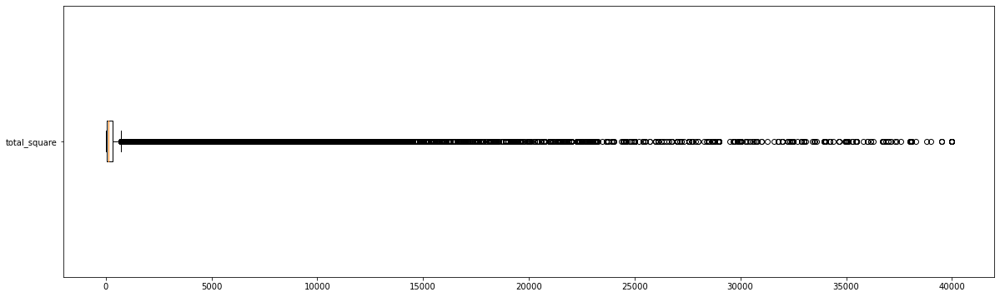

In [12]:
FIGSIZE = (20,6)
plt.figure(figsize=FIGSIZE)
plt.boxplot(train_df['total_square'], labels=['total_square'],vert=False)
plt.show()

In [13]:
train_df['total_square'].describe()

count   279792.000
mean       507.834
std       1704.252
min          5.100
25%         65.900
50%        128.737
75%        336.000
max      40000.000
Name: total_square, dtype: float64

In [14]:
train_df.describe()

,lat,lng,osm_amenity_points_in_0.001,osm_amenity_points_in_0.005,osm_amenity_points_in_0.0075,osm_amenity_points_in_0.01,osm_building_points_in_0.001,osm_building_points_in_0.005,osm_building_points_in_0.0075,osm_building_points_in_0.01,osm_catering_points_in_0.001,osm_catering_points_in_0.005,osm_catering_points_in_0.0075,osm_catering_points_in_0.01,osm_city_closest_dist,osm_city_nearest_population,osm_crossing_closest_dist,osm_crossing_points_in_0.001,osm_crossing_points_in_0.005,osm_crossing_points_in_0.0075,osm_crossing_points_in_0.01,osm_culture_points_in_0.001,osm_culture_points_in_0.005,osm_culture_points_in_0.0075,osm_culture_points_in_0.01,osm_finance_points_in_0.001,osm_finance_points_in_0.005,osm_finance_points_in_0.0075,osm_finance_points_in_0.01,osm_healthcare_points_in_0.005,osm_healthcare_points_in_0.0075,osm_healthcare_points_in_0.01,osm_historic_points_in_0.005,osm_historic_points_in_0.0075,osm_historic_points_in_0.01,osm_hotels_points_in_0.005,osm_hotels_points_in_0.0075,osm_hotels_points_in_0.01,osm_leisure_points_in_0.005,osm_leisure_points_in_0.0075,osm_leisure_points_in_0.01,osm_offices_points_in_0.001,osm_offices_points_in_0.005,osm_offices_points_in_0.0075,osm_offices_points_in_0.01,osm_shops_points_in_0.001,osm_shops_points_in_0.005,osm_shops_points_in_0.0075,osm_shops_points_in_0.01,osm_subway_closest_dist,osm_train_stop_closest_dist,osm_train_stop_points_in_0.005,osm_train_stop_points_in_0.0075,osm_train_stop_points_in_0.01,osm_transport_stop_closest_dist,osm_transport_stop_points_in_0.005,osm_transport_stop_points_in_0.0075,osm_transport_stop_points_in_0.01,per_square_meter_price,reform_count_of_houses_1000,reform_count_of_houses_500,reform_house_population_1000,reform_house_population_500,reform_mean_floor_count_1000,reform_mean_floor_count_500,reform_mean_year_building_1000,reform_mean_year_building_500,total_square,realty_type,price_type
count,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279737.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,279792.000,265196.000,252558.000,263084.000,249624.000,263553.000,250155.000,279792.000,279792.000,279792.000
mean,54.364,47.764,2.709,40.605,81.596,133.285,0.037,0.886,2.046,3.748,0.614,8.811,17.409,28.341,15.517,2584429.575,0.519,0.737,14.098,29.307,48.715,0.072,1.488,3.258,5.556,0.146,2.050,4.041,6.442,2.031,4.153,6.836,1.681,3.680,6.226,1.043,2.144,3.556,2.023,4.188,7.048,0.239,3.109,6.217,10.217,1.621,22.637,44.802,72.467,170.931,9.605,0.079,0.196,0.348,0.576,6.263,12.951,21.619,110195.469,100.454,30.111,2042.542,644.611,7.051,7.360,1967.533,1967.989,507.834,54.974,0.016
std,4.246,17.045,4.202,53.293,105.193,172.290,0.391,6.858,14.802,25.680,1.695,17.713,33.267,53.790,34.756,4110834.625,4.012,1.387,15.136,30.232,49.247,0.373,4.407,8.816,13.995,0.458,3.371,6.111,9.352,3.332,6.429,10.338,3.909,7.823,12.737,3.312,6.423,10.342,3.043,5.687,9.094,0.738,5.518,10.721,17.458,2.659,28.429,54.183,86.561,217.642,26.603,0.530,0.914,1.310,4.597,5.559,10.206,16.263,172050.584,85.489,27.686,1359.885,445.699,3.542,4.231,45.808,54.110,1704.252,47.856,0.126
min,42.652,19.892,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.001,44389.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.001,0.002,0.000,0.000,0.000,0.000,0.000,0.000,0.000,389.610,0.000,0

#### Top correlations

In [15]:
corr_pos = train_df.corr(method='pearson', min_periods=1).sort_values(by=TARGET,ascending=False).iloc[1:15][TARGET]
corr_pos

osm_city_nearest_population       0.552
osm_catering_points_in_0.005      0.489
osm_amenity_points_in_0.005       0.484
osm_amenity_points_in_0.01        0.477
osm_amenity_points_in_0.0075      0.476
osm_catering_points_in_0.0075     0.472
osm_catering_points_in_0.01       0.463
osm_leisure_points_in_0.01        0.462
osm_healthcare_points_in_0.01     0.460
osm_shops_points_in_0.01          0.441
osm_healthcare_points_in_0.0075   0.440
osm_amenity_points_in_0.001       0.437
osm_shops_points_in_0.005         0.433
osm_shops_points_in_0.0075        0.433
Name: per_square_meter_price, dtype: float64

In [16]:
corr_neg = train_df.corr(method='pearson', min_periods=1).sort_values(by=TARGET,ascending=True).iloc[0:5][TARGET]
corr_neg

osm_subway_closest_dist          -0.269
lng                              -0.222
osm_city_closest_dist            -0.135
osm_train_stop_closest_dist      -0.124
reform_mean_year_building_1000   -0.085
Name: per_square_meter_price, dtype: float64

In [17]:
columns_corr = [*corr_pos.index, *corr_neg.index]

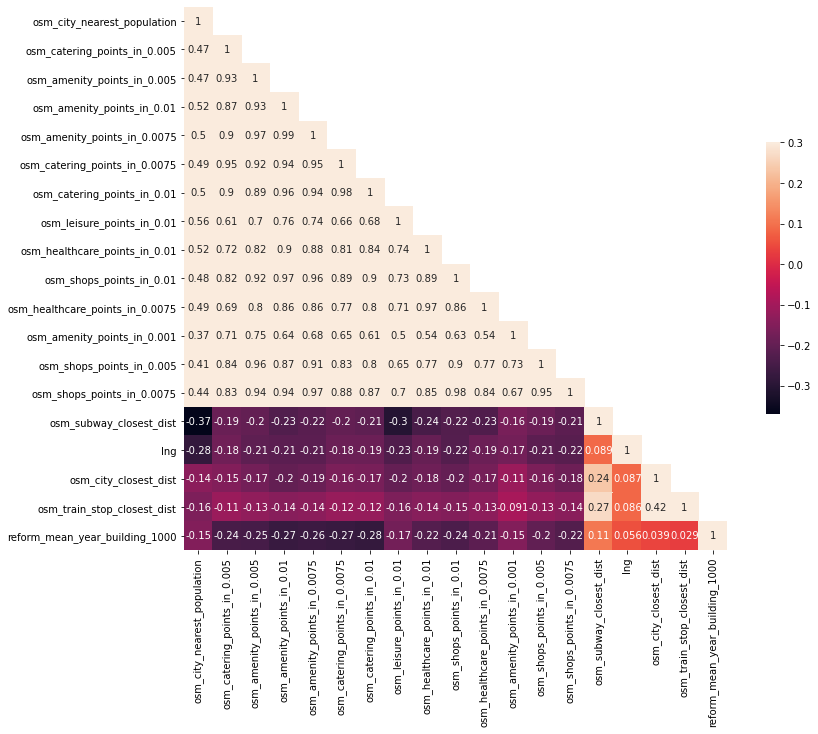

In [18]:
corrMatrix = train_df[columns_corr].corr(method='pearson', min_periods=1)
plt.figure(figsize=(14,10))
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corrMatrix, dtype=bool), k=1)
ax = sns.heatmap(corrMatrix, square=True, vmax=.3, annot=True, mask=mask, cbar_kws={"shrink": .5})
plt.show()

#### Geo

In [19]:
import branca.colormap as cm

df_map = train_df.sample(frac=0.05, random_state=42)

geolocator = Nominatim(user_agent="ny_explorer")
address = 'Moscow'
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))

moscow_map = folium.Map(location=[latitude, longitude], zoom_start=8)

colormap = cm.LinearColormap(colors=['red','blue'],
                             index=[min(df_map[TARGET]), max(df_map[TARGET])/2],
                             vmin=min(df_map[TARGET]),vmax=max(df_map[TARGET])/2)

for label, latitude, longitude, c in zip(df_map[['region', 'city', 'id']].agg(', '.join, axis=1),
                                         df_map['lat'], df_map['lng'], df_map[TARGET]):
    folium.CircleMarker(
        [latitude, longitude],
        radius=2,
        popup=label,
        color=colormap(c),
        parse_html=False).add_to(moscow_map)
                                                                                                                    
                                                                                                                
moscow_map.add_child(colormap)

moscow_map

The geograpical coordinate of Moscow are 55.7504461, 37.6174943.


## Preprocess

In [20]:
def prepare_categorical(df: pd.DataFrame) -> pd.DataFrame:
    """
    Заполняет пропущенные категориальные переменные
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()
    fillna_cols = ['region','city','street',]
    df_new[fillna_cols] = df_new[fillna_cols].fillna(UNKNOWN_VALUE)
    return df_new


def prepare_floor(df: pd.DataFrame) -> pd.DataFrame:
    """
    Обработка
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()

    def parse_floor(floor):
        try:
            return str(int(float(floor)))
        except Exception as e:
            if isinstance(floor, str):
                under = 1
                if 'подвал' in floor or 'цоколь' in floor:
                    under = -1
                if re.findall('\d+', floor):
                    return int(re.findall('\d+', floor)[0]) * under
            elif np.isnan(floor):
                return "nan"

    def parse_floor_cat(floor):
        MANY_FLOORS = 'many'
        UNDER = 'underfloor'
        OUTSIDE = 'ouside'

        if isinstance(floor, str):
            splits = [x.strip() for x in floor.split(',') if x.strip() != '']
            if len(splits) == 1:
                if re.match("[0-9]\s*-\s*[0-9]", floor):
                    return MANY_FLOORS
                if re.match("[0-9]\s*-\s*\D", floor):
                    return floor.split('-')[0].strip()
                if "+" in floor:
                    return MANY_FLOORS
                if 'подва' in floor.lower() or 'цоколь' in floor.lower():
                    return UNDER
                if 'антресоль' in floor.lower() or 'чердак' in floor.lower() or 'мансарда' in floor.lower():
                    return OUTSIDE
                if 'тех' in floor.lower():
                    return 'tech'
                if re.findall('\d+', floor):
                    digit = int(re.findall('\d+', floor)[0])
                    if digit > 10:
                        return 'very high'
                    elif digit > 2:
                        return 'high'
                    elif digit < 0:
                        return UNDER
                    else:
                        return 'ground'
                return 'another'
            else:
                return MANY_FLOORS
        if np.isnan(floor):
            return "nan"

    df_new['floor_cat'] = df_new['floor'].apply(parse_floor_cat)
    df_new['floor'] = df_new['floor'].apply(parse_floor)

    return df_new


def add_economic(df: pd.DataFrame) -> pd.DataFrame:
    """
    Добавляет экономические данные
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()
    df_eco_stats = pd.read_csv('../data/economic_stats_regions.csv', index_col=0)

    def merge_columns(df_source, df_dist, column):
        return df_dist.merge(df_source, on=column)

    df_new = merge_columns(df_eco_stats, df_new, 'region')

    return df_new.sort_values('id')


def prepare_square(df: pd.DataFrame) -> pd.DataFrame:
    """
    Обработка square
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()

    def cat_square(total_square):
        if total_square < 20 and total_square > 0:
            return 'very small'
        elif total_square < 100 and total_square >= 20:
            return 'small'
        elif total_square < 300 and total_square >= 100:
            return 'medium'
        elif total_square < 1000 and total_square >= 300:
            return 'medium big'
        elif total_square < 5000 and total_square >= 1000:
            return 'big'
        elif total_square > 5000:
            return 'very big'
        else:
            return UNKNOWN_VALUE

    df_new['square_cat'] = df_new['total_square'].apply(cat_square)

    return df_new


def prepare_building(df: pd.DataFrame) -> pd.DataFrame:
    """
    Обработка osm_building_points
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()

    df_new['building_cat'] = df_new.apply(lambda x: 1 if ((x['osm_building_points_in_0.001'] > 0)
                                                          & (x['osm_building_points_in_0.0075'] > 0)
                                                          & (x['osm_building_points_in_0.01'] > 1)) else 0, axis=1)

    return df_new


def prepare_amenity(df: pd.DataFrame) -> pd.DataFrame:
    """
    Обработка osm_amenity_points
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()

    df_new['amenity_cat'] = df_new.apply(lambda x: 1 if ((x['osm_amenity_points_in_0.001'] > 2)
                                                          & (x['osm_amenity_points_in_0.0075'] > 10)
                                                          & (x['osm_amenity_points_in_0.01'] > 20)) else 0, axis=1)

    return df_new

def prepare_historic(df: pd.DataFrame) -> pd.DataFrame:
    """
    Обработка osm_historic_points
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    df_new = df.copy()

    df_new['historic_cat'] = df_new.apply(lambda x: 1 if ((x['osm_historic_points_in_0.005'] > 2)
                                                          & (x['osm_historic_points_in_0.0075'] > 3)
                                                          & (x['osm_historic_points_in_0.01'] > 10)) else 0, axis=1)

    return df_new


def add_metro(df: pd.DataFrame) -> pd.DataFrame:
    """
    Создание признака наличия метро
    :param df: dataframe, обучающая выборка
    :return: dataframe
    """
    new_df = df.copy()
    metro_cities = ['Москва', 'Санкт-Петербург', 'Казань', 'Екатеринбург', 'Нижний Новгород', 'Новосибирск', 'Самара']
    # train
    is_metro = []
    for city in new_df['city']:
        if city in metro_cities:
            is_metro.append(1)
        else:
            is_metro.append(0)
    new_df['is_metro'] = is_metro

    new_osm_subway_closest_dist = []
    subway_500 = []
    subway_1000 = []
    subway_2000 = []
    for dist, metro_bool in zip(new_df['osm_subway_closest_dist'], new_df['is_metro']):
        if is_metro == 0:
            new_osm_subway_closest_dist.append(0)
        elif dist > 3:
            new_osm_subway_closest_dist.append(0.33)
        elif dist < 0.1:
            new_osm_subway_closest_dist.append(10)
        else:
            new_osm_subway_closest_dist.append(1 / dist)

        if dist < 0.5:
            subway_500.append(1)
            subway_1000.append(1)
            subway_2000.append(1)
        elif dist < 1:
            subway_500.append(0)
            subway_1000.append(1)
            subway_2000.append(1)
        elif dist < 2:
            subway_500.append(0)
            subway_1000.append(0)
            subway_2000.append(1)
        else:
            subway_500.append(0)
            subway_1000.append(0)
            subway_2000.append(0)

    new_df['osm_subway_closest_dist'] = new_osm_subway_closest_dist
    new_df['subway_500'] = subway_500
    new_df['subway_1000'] = subway_1000
    new_df['subway_2000'] = subway_2000

    return new_df

def change_region(df):
    new_df = df.copy()
    change_region_dict = {
        'Адыгея':'Республика Адыгея',
        'Татарстан':'Республика Татарстан',
        'Мордовия': 'Республика Мордовия',
        'Коми': 'Республика Коми',
        'Карелия': 'Республика Карелия',
        'Башкортостан': 'Республика Башкортостан',
        'Ханты-Мансийский АО':'Ханты-Мансийский автономный округ - Югра',
        'Удмуртия':'Удмуртская республика'
    }

    change_city_dict = {
        'Иркутский район, Маркова рп, Зеленый Берег мкр':'Маркова',
        'Иркутский район, Маркова рп, Стрижи кв-л':'Маркова',
        'город Светлый':'Светлый',
        'Орел':'Орёл'
    }


    def custom_func(region,city):
        if (region == 'Ленинградская область') and (city=='Санкт-Петербург'):
            return 'Санкт-Петербург'
        if (region == 'Тюменская область') and (city=='Нижневартовск'):
            return 'Ханты-Мансийский автономный округ - Югра'
        if (region == 'Тюменская область') and (city=='Сургут'):
            return 'Ханты-Мансийский автономный округ - Югра'
        return region

    for err, new in zip(list(change_city_dict.keys()),list(change_city_dict.values())):
        new_df.replace(err, new, inplace=True)

    for err, new in zip(list(change_region_dict.keys()),list(change_region_dict.values())):
        new_df.replace(err, new, inplace=True)
        new_df['region'] = new_df.apply(lambda x: custom_func(x['region'],x['city']),axis=1)

    return new_df

def prepare_population(df):
    new_df = df.copy()

    def population(city):
        if not city:
            return UNKNOWN_VALUE
        
        if city in ['Москва']:
            return 4
        elif city in ['Санкт-Петербург']:
            return 3
        elif city in ['Новосибирск', 'Екатеринбург', 'Казань', 'Нижний Новгород', 'Челябинск', 'Самара', 'Омск',
                      'Сочи']:
            return 2
        elif city in ['Ростов-на-Дону', 'Уфа', 'Красноярск', 'Воронеж', 'Пермь', 'Волгоград', 'Краснодар',
                      'Саратов', 'Тюмень']:
            return 1
        else:
            return 0

    def population_region(region):
        if not region:
            return UNKNOWN_VALUE

        if region in ['Москва', 'Московская область', 'Санкт-Петербург', 'Краснодарский край']:
            return 1
        else:
            return 0
        
    new_df['population_city_cat'] = new_df['city'].apply(population) 
    new_df['population_region_cat'] = new_df['region'].apply(population_region)    
        
    return new_df

In [21]:
print(f'Input shape: {train_df.shape}')
train_df = prepare_square(train_df)
train_df = prepare_building(train_df)
train_df = prepare_amenity(train_df)
train_df = prepare_historic(train_df)
train_df = prepare_categorical(train_df)
train_df = prepare_floor(train_df)
train_df = add_economic(train_df)
train_df = add_metro(train_df)
train_df = change_region(train_df)
train_df = prepare_population(train_df)
print(f'Preprocessed shape: {train_df.shape}')

Input shape: (279792, 77)
Preprocessed shape: (279792, 91)


In [22]:
print(f'Input shape: {test_df.shape}')
test_df = prepare_square(test_df)
test_df = prepare_building(test_df)
test_df = prepare_amenity(test_df)
test_df = prepare_historic(test_df)
test_df = prepare_categorical(test_df)
test_df = prepare_floor(test_df)
test_df = add_economic(test_df)
test_df = add_metro(test_df)
test_df = change_region(test_df)
test_df = prepare_population(test_df)
print(f'Preprocessed shape: {test_df.shape}')

Input shape: (2974, 76)
Preprocessed shape: (2974, 90)


In [23]:
train_df.head()

,city,floor,id,lat,lng,osm_amenity_points_in_0.001,osm_amenity_points_in_0.005,osm_amenity_points_in_0.0075,osm_amenity_points_in_0.01,osm_building_points_in_0.001,osm_building_points_in_0.005,osm_building_points_in_0.0075,osm_building_points_in_0.01,osm_catering_points_in_0.001,osm_catering_points_in_0.005,osm_catering_points_in_0.0075,osm_catering_points_in_0.01,osm_city_closest_dist,osm_city_nearest_name,osm_city_nearest_population,osm_crossing_closest_dist,osm_crossing_points_in_0.001,osm_crossing_points_in_0.005,osm_crossing_points_in_0.0075,osm_crossing_points_in_0.01,osm_culture_points_in_0.001,osm_culture_points_in_0.005,osm_culture_points_in_0.0075,osm_culture_points_in_0.01,osm_finance_points_in_0.001,osm_finance_points_in_0.005,osm_finance_points_in_0.0075,osm_finance_points_in_0.01,osm_healthcare_points_in_0.005,osm_healthcare_points_in_0.0075,osm_healthcare_points_in_0.01,osm_historic_points_in_0.005,osm_historic_points_in_0.0075,osm_historic_points_in_0.01,osm_hotels_points_in_0.005,osm_hotels_points_in_0.0075,osm_hotels_points_in_0.01,osm_leisure_points_in_0.005,osm_leisure_points_in_0.0075,osm_leisure_points_in_0.01,osm_offices_points_in_0.001,osm_offices_points_in_0.005,osm_offices_points_in_0.0075,osm_offices_points_in_0.01,osm_shops_points_in_0.001,osm_shops_points_in_0.005,osm_shops_points_in_0.0075,osm_shops_points_in_0.01,osm_subway_closest_dist,osm_train_stop_closest_dist,osm_train_stop_points_in_0.005,osm_train_stop_points_in_0.0075,osm_train_stop_points_in_0.01,osm_transport_stop_closest_dist,osm_transport_stop_points_in_0.005,osm_transport_stop_points_in_0.0075,osm_transport_stop_points_in_0.01,per_square_meter_price,reform_count_of_houses_1000,reform_count_of_houses_500,reform_house_population_1000,reform_house_population_500,reform_mean_floor_count_1000,reform_mean_floor_count_500,reform_mean_year_building_1000,reform_mean_year_building_500,region,total_square,street,date,realty_type,price_type,square_cat,building_cat,amenity_cat,historic_cat,floor_cat,salary_to_product,poor,very_poor,is_metro,subway_500,subway_1000,subway_2000,population_city_cat,population_region_cat
0,Пермь,nan,COL_0,57.998,56.293,4,19,35,52,0,0,0,0,0,2,4,6,3.293,Пермь,1055397.000,0.028,3,6,17,34,0,0,1,1,0,0,1,2,2,3,4,0,0,1,0,0,0,0,1,2,0,1,2,4,4,11,20,28,0.330,3.368,0,0,0,0.003,4,13,21,139937.500,136,49,2503.000,765.000,5.763,5.531,1964.119,1960.959,Пермский край,32.000,S27289,2020-01-05,10,0,small,0,1,0,nan,1.450,13.300,1.800,0,0,0,0,1,0
5466,Шатура,nan,COL_1,55.574,39.544,3,24,37,59,0,0,0,1,0,2,2,6,43.951,Орехово-Зуево,120184.000,0.089,0,31,50,57,0,1,2,3,0,0,1,2,1,1,3,2,4,6,2,2,2,1,1,2,0,1,2,3,1,12,20,29,0.330,1.477,0,0,0,0.155,4,10,11,60410.714,146,37,1336.000,514.000,2.894,3.528,1952.322,1957.222,Московская область,280.000,S17052,2020-01-05,10,0,medium,0,1,0,nan,1.970,6.800,0.600,0,0,0,0,0,1
106798,Краснодар,nan,COL_10,45.065,39.032,0,12,32,51,0,1,2,4,0,2,3,5,5.513,Краснодар,1405000.000,0.094,2,10,21,50,0,0,1,1,0,0,0,0,0,1,3,0,0,0,0,0,0,0,3,4,0,1,5,5,0,10,24,40,0.330,6.223,0,0,0,0.159,6,9,25,31100.000,170,48,5936.000,1512.000,13.699,11.975,2011.167,2011.800,Краснодарский край,40.000,S28356,2020-01-05,10,0,small,0,0,0,nan,1.610,10.600,1.400,0,0,0,0,1,1
164718,Воронеж,nan,COL_100,51.710,39.183,13,79,136,308,0,1,1,3,1,5,13,33,5.640,Воронеж,1023570.000,0.120,0,14,25,51,0,2,3,5,1,3,4,7,8,9,15,1,6,9,1,1,1,7,9,18,0,6,11,18,6,49,86,220,0.330,3.678,0,0,0,0.111,4,10,31,63510.638,104,27,5138.000,1719.000,11.620,14.731,1995.911,2007.192,Воронежская область,47.000,S16738,2020-01-05,10,0,small,0,1,0,nan,1.580,8.500,1.000,0,0,0,0,1,0
21803,Ярославль,nan,COL_1000,57.589,39.904,2,12,13,24,0,0,0,0,0,0,0,0,4.254,Ярославль,603961.000,0.142,0,14,19,22,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,1,1,8,9,17,0.330,3.863,0,0,0,0.265,4,6,8,84575.000,84,11,1023.000,413.000,6.449,9.636,1975.434,2006.273,Ярославская область,120.000,S27486,2020-01-05,110,0,medium,0,0,0,nan,1.480,9.900,0.900,0,0,0,0,0,0


In [24]:
# признаки (или набор признаков), для которых применяем smoothed target encoding
CATEGORICAL_STE_FEATURES = ['region', 'city', 'realty_type', 'floor_cat', 'floor', 'building_cat', 'square_cat',
                            'amenity_cat', 'historic_cat', 'subway_500', 'subway_1000', 'subway_2000',
                            'population_city_cat', 'population_region_cat']

# признаки, для которых применяем one hot encoding
CATEGORICAL_OHE_FEATURES = []

# численные признаки
NUM_FEATURES = ['lat', 'lng', 'osm_amenity_points_in_0.001',
       'osm_amenity_points_in_0.005', 'osm_amenity_points_in_0.0075',
       'osm_amenity_points_in_0.01', 'osm_building_points_in_0.001',
       'osm_building_points_in_0.005', 'osm_building_points_in_0.0075',
       'osm_building_points_in_0.01', 'osm_catering_points_in_0.001',
       'osm_catering_points_in_0.005', 'osm_catering_points_in_0.0075',
       'osm_catering_points_in_0.01', 'osm_city_closest_dist',
       'osm_city_nearest_population',
       'osm_crossing_closest_dist', 'osm_crossing_points_in_0.001',
       'osm_crossing_points_in_0.005', 'osm_crossing_points_in_0.0075',
       'osm_crossing_points_in_0.01', 'osm_culture_points_in_0.001',
       'osm_culture_points_in_0.005', 'osm_culture_points_in_0.0075',
       'osm_culture_points_in_0.01', 'osm_finance_points_in_0.001',
       'osm_finance_points_in_0.005', 'osm_finance_points_in_0.0075',
       'osm_finance_points_in_0.01', 'osm_healthcare_points_in_0.005',
       'osm_healthcare_points_in_0.0075', 'osm_healthcare_points_in_0.01',
       'osm_historic_points_in_0.005', 'osm_historic_points_in_0.0075',
       'osm_historic_points_in_0.01', 'osm_hotels_points_in_0.005',
       'osm_hotels_points_in_0.0075', 'osm_hotels_points_in_0.01',
       'osm_leisure_points_in_0.005', 'osm_leisure_points_in_0.0075',
       'osm_leisure_points_in_0.01', 'osm_offices_points_in_0.001',
       'osm_offices_points_in_0.005', 'osm_offices_points_in_0.0075',
       'osm_offices_points_in_0.01', 'osm_shops_points_in_0.001',
       'osm_shops_points_in_0.005', 'osm_shops_points_in_0.0075',
       'osm_shops_points_in_0.01', 'osm_subway_closest_dist',
       'osm_train_stop_closest_dist', 'osm_train_stop_points_in_0.005',
       'osm_train_stop_points_in_0.0075', 'osm_train_stop_points_in_0.01',
       'osm_transport_stop_closest_dist', 'osm_transport_stop_points_in_0.005',
       'osm_transport_stop_points_in_0.0075',
       'osm_transport_stop_points_in_0.01',
       'reform_count_of_houses_1000', 'reform_count_of_houses_500',
       'reform_house_population_1000', 'reform_house_population_500',
       'reform_mean_floor_count_1000', 'reform_mean_floor_count_500',
       'reform_mean_year_building_1000', 'reform_mean_year_building_500','total_square',
       'salary_to_product', 'poor', 'very_poor'
    ]

### Model

In [25]:
import typing
from sklearn.base import BaseEstimator,TransformerMixin

class SmoothedTargetEncoding(BaseEstimator,TransformerMixin):
    """Регуляризованный таргет энкодинг.

    :param categorical_features: список из столбцов с категориальными признаками, которые нужно заэнкодить
    :param alpha: параметр регуляризации
    """

    def __init__(self, categorical_features: typing.List[str], alpha: float = 50.0):
        self.__is_fitted = False
        self.categorical_features = categorical_features
        self.alpha = alpha
        self.mean_price = None
        self.mean_price_by_cat = {}
        self.encoded_preffix = "encoded_"
        self.target = 'target'

    def smoothed_target_encoding(self, y: pd.Series) -> pd.Series:
        """Реализация регуляризованного таргед энкодинга.

        Принцип такой - чем меньше исходных данных, тем сильнее будет регуляризация
        Параметр регуляризации регуляризует мин. кол-во необходимых данных
        :param y: pd.Series с ценой
        :return: pd.Series с регуляризованной ценой
        """
        nrows = y.notnull().sum()
        return (y.mean() * nrows + self.alpha * self.mean_price) / (nrows + self.alpha)

    def fit(self, X: pd.DataFrame, y: typing.Union[np.array, pd.Series] = None):
        """На основе обучающей выборки запоминает средние цены в разрезе категорий.

        :param X: pd.DataFrame, обучающая выборка
        :param y: target
        :return:
        """
        X[self.target] = y
        self.mean_price = X[self.target].mean()
        for col in self.categorical_features:
            self.mean_price_by_cat[col] = (
                X.groupby(col)[self.target].apply(lambda x: self.smoothed_target_encoding(x)).fillna(self.mean_price)
            )

        X.drop(self.target, axis=1, inplace=True)
        self.__is_fitted = True
        return self

    def transform(self, X: pd.DataFrame, y: typing.Union[np.array, pd.Series] = None):
        """Применение регуляризованного таргет энкодинга.

        :param X: pd.DataFrame, обучающая выборка
        :return:
        """
        X_cp = X.copy()
        if self.__is_fitted:
            encoded_cols = []
            for col in self.categorical_features:
                new_col = self.encoded_preffix + col
                X_cp[new_col] = X_cp[col].map(self.mean_price_by_cat[col]).fillna(self.mean_price)
                encoded_cols.append(new_col)
            return X_cp[encoded_cols]
        else:
            raise NotFittedError(
                "This {} instance is not fitted yet. Call 'fit' with appropriate arguments before using this transformer".format(
                    type(self).__name__
                )
            )

In [26]:
smooth_target_encoding = SmoothedTargetEncoding(CATEGORICAL_STE_FEATURES)
smooth_target_encoding.fit(train_df, train_df[TARGET])

SmoothedTargetEncoding(categorical_features=['region', 'city', 'realty_type',
                                             'floor_cat', 'floor',
                                             'building_cat', 'square_cat',
                                             'amenity_cat', 'historic_cat',
                                             'subway_500', 'subway_1000',
                                             'subway_2000',
                                             'population_city_cat',
                                             'population_region_cat'])

In [27]:
train_df[CATEGORICAL_STE_FEATURES] = smooth_target_encoding.transform(train_df)
test_df[CATEGORICAL_STE_FEATURES] = smooth_target_encoding.transform(test_df)

In [28]:
encoder = OrdinalEncoder(handle_unknown='use_encoded_value',unknown_value=-1)
train_df[CATEGORICAL_STE_FEATURES] = encoder.fit_transform(train_df[CATEGORICAL_STE_FEATURES])
test_df[CATEGORICAL_STE_FEATURES] = encoder.transform(test_df[CATEGORICAL_STE_FEATURES])

In [29]:
scaler = StandardScaler()
train_df[NUM_FEATURES] = scaler.fit_transform(train_df[NUM_FEATURES])
test_df[NUM_FEATURES] = scaler.transform(test_df[NUM_FEATURES])

### Model

In [31]:
SEED = 91

MODEL_PARAMS = dict(
    n_estimators=2000,
    learning_rate=0.05,
    reg_alpha=2,
    num_leaves=40,
    min_child_samples=5,
    importance_type="gain",
    n_jobs=-1,
    random_state=SEED,
)

In [32]:
print(f'Input shape: {train_df.shape}')

X_offer = train_df[train_df.price_type == PriceTypeEnum.OFFER_PRICE][
    NUM_FEATURES + CATEGORICAL_OHE_FEATURES + CATEGORICAL_STE_FEATURES]
y_offer = train_df[train_df.price_type == PriceTypeEnum.OFFER_PRICE][TARGET]
X_manual = train_df[train_df.price_type == PriceTypeEnum.MANUAL_PRICE][
    NUM_FEATURES + CATEGORICAL_OHE_FEATURES + CATEGORICAL_STE_FEATURES]
y_manual = train_df[train_df.price_type == PriceTypeEnum.MANUAL_PRICE][TARGET]

Input shape: (279792, 91)


In [33]:
model = LGBMRegressor(**MODEL_PARAMS)
model.fit(X_offer, y_offer)

LGBMRegressor(importance_type='gain', learning_rate=0.05, min_child_samples=5,
              n_estimators=2000, num_leaves=40, random_state=91, reg_alpha=2)

In [34]:
def find_corr_coefficient(X_manual: pd.DataFrame, y_manual: pd.Series):
    """Вычисление корректирующего коэффициента

    :param X_manual: pd.DataFrame с ручными оценками
    :param y_manual: pd.Series - цены ручника
    """
    predictions = model.predict(X_manual)
    deviation = ((y_manual - predictions)/predictions).median()
    return deviation
        
corr_coef = find_corr_coefficient(X_manual, y_manual)
print(f'Corr coef: {corr_coef:.2f}')

Corr coef: -0.11


### Evaluate

In [35]:
from sklearn.metrics import mean_absolute_percentage_error, r2_score, mean_squared_error

THRESHOLD = 0.15
NEGATIVE_WEIGHT = 1.1

def deviation_metric_one_sample(y_true: typing.Union[float, int], y_pred: typing.Union[float, int]) -> float:
    """
    Реализация кастомной метрики для хакатона.

    :param y_true: float, реальная цена
    :param y_pred: float, предсказанная цена
    :return: float, значение метрики
    """
    deviation = (y_pred - y_true) / np.maximum(1e-8, y_true)
    if np.abs(deviation) <= THRESHOLD:
        return 0
    elif deviation <= - 4 * THRESHOLD:
        return 9 * NEGATIVE_WEIGHT
    elif deviation < -THRESHOLD:
        return NEGATIVE_WEIGHT * ((deviation / THRESHOLD) + 1) ** 2
    elif deviation < 4 * THRESHOLD:
        return ((deviation / THRESHOLD) - 1) ** 2
    else:
        return 9


def deviation_metric(y_true: np.array, y_pred: np.array) -> float:
    return np.array([deviation_metric_one_sample(y_true[n], y_pred[n]) for n in range(len(y_true))]).mean()

def median_absolute_percentage_error(y_true: np.array, y_pred: np.array) -> float:
    return np.median(np.abs(y_pred-y_true)/y_true)

def metrics_stat(y_true: np.array, y_pred: np.array) -> typing.Dict[str,float]:
    mape = mean_absolute_percentage_error(y_true, y_pred)
    mdape = median_absolute_percentage_error(y_true, y_pred)
    rmse = mean_squared_error(y_true, y_pred, squared=False)
    r2 = r2_score(y_true, y_pred)
    raif_metric = deviation_metric(y_true, y_pred)
    return {'mape':mape, 'mdape':mdape, 'rmse':rmse, 'r2':r2, 'raif_metric':raif_metric}

EPS = 1e-8
assert deviation_metric(np.array([1,2,3,4,5]),np.array([1,2,3,4,5])) <= EPS
assert deviation_metric(np.array([1,2,3,4,5]),np.array([0.9,1.8,2.7,3.6,4.5])) <= EPS
assert deviation_metric(np.array([1,2,3,4,5]),np.array([1.1,2.2,3.3,4.4,5.5])) <= EPS
assert deviation_metric(np.array([1,2,3,4,5]),np.array([1.15,2.3,3.45,4.6,5.75])) <= EPS
assert np.abs(deviation_metric(np.array([1,2,3,4,5]),np.array([1.3,2.6,3.9,5.2,6.5]))-1) <= EPS
assert np.abs(deviation_metric(np.array([1,2,3,4,5]),np.array([0.7,1.4,2.1,2.8,3.5]))-1*NEGATIVE_WEIGHT) <= EPS
assert np.abs(deviation_metric(np.array([1,2,3,4,5]),np.array([10,20,30,40,50]))-9) <= EPS
assert np.abs(deviation_metric(np.array([1,2,3,4,5]),np.array([0,0,0,0,0]))-9*NEGATIVE_WEIGHT) <= EPS
assert np.abs(deviation_metric(np.array([1,2,3,4,5]),np.array([1,2.2,3.3,5,50])) - 85/45) <= EPS

In [36]:
predictions_offer = model.predict(X_offer)
# для обучающей выборки с ценами из объявлений смотрим качество без коэффициента
metrics = metrics_stat(y_offer.values, predictions_offer / (1 + corr_coef))
print(f'Metrics stat for training data with offers prices: {metrics}')

Metrics stat for training data with offers prices: {'mape': 1.490999335733249, 'mdape': 0.29409066201542633, 'rmse': 56684.91351657051, 'r2': 0.8926292089072985, 'raif_metric': 3.43585112622245}


In [37]:
predictions_manual = model.predict(X_manual)
metrics = metrics_stat(y_manual.values, predictions_manual)
print(f'Metrics stat for training data with manual prices: {metrics}')

Metrics stat for training data with manual prices: {'mape': 0.3721711352040685, 'mdape': 0.2741419167535098, 'rmse': 73178.62417923711, 'r2': 0.33008444207702736, 'raif_metric': 2.7130936768629605}


In [38]:
feature_importance_df = pd.DataFrame(model.feature_importances_ , index=X_offer.columns)
feature_importance_df = feature_importance_df / 10**11
feature_importance_df.sort_values(by=0, ascending=False)

,0
osm_city_nearest_population,188390.365
city,99016.629
total_square,68708.635
osm_amenity_points_in_0.005,46992.836
osm_subway_closest_dist,33147.155
realty_type,26556.535
osm_amenity_points_in_0.001,14356.598
floor,13459.474
lng,13385.132
osm_shops_points_in_0.005,13054.939


In [39]:
test_df['per_square_meter_price'] \
= model.predict(test_df[NUM_FEATURES+CATEGORICAL_OHE_FEATURES+CATEGORICAL_STE_FEATURES])

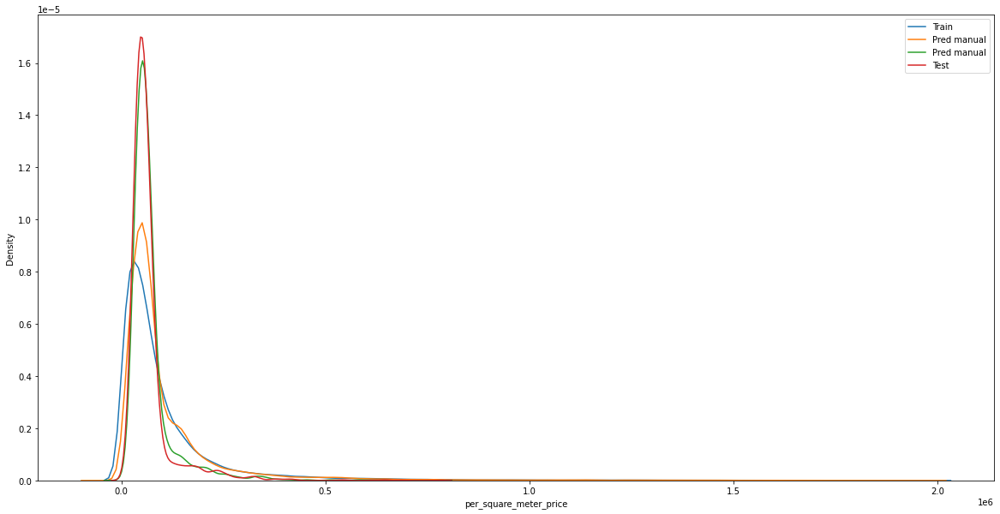

In [42]:
test_df[TARGET] = test_df[TARGET] * 0.95

fig = plt.figure(figsize=(20,10))
sns.kdeplot(data=train_df, x=TARGET, label='Train')
sns.kdeplot(data=predictions_offer, label='Pred manual')
sns.kdeplot(data=predictions_manual, label='Pred manual')
sns.kdeplot(data=test_df, x=TARGET, label='Test')
plt.legend(loc="upper right")
plt.show()

In [43]:
test_df[['id','per_square_meter_price']].to_csv('./output.csv', index=False)